In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import matplotlib.pyplot as plt

In [ ]:
path = "dataset4-2.csv"
df = pd.read_csv(path)

### Count the number of cows in the dataset

In [ ]:
num_cows = df['cow'].nunique()
print(f"Total number of unique cows: {num_cows}")

Total number of unique cows: 25


### Display the ids of cows

In [ ]:
unique_cow_ids = df['cow'].unique()
print("List of unique cow IDs:")
print(unique_cow_ids)  # Prints all IDs as an array

sorted_cow_ids = sorted(df['cow'].unique())
print("\nSorted list of cow IDs:")
print(sorted_cow_ids)

List of unique cow IDs:
[35687 42599 44432 45683 46649 47875 47899 48094 48133 48599 48589 48642
 48492 48500 48531 48555 49378 49382 49407 49428 49435 49230 49149 49108
 49097]

Sorted list of cow IDs:
[35687, 42599, 44432, 45683, 46649, 47875, 47899, 48094, 48133, 48492, 48500, 48531, 48555, 48589, 48599, 48642, 49097, 49108, 49149, 49230, 49378, 49382, 49407, 49428, 49435]


### Detect outliers of features

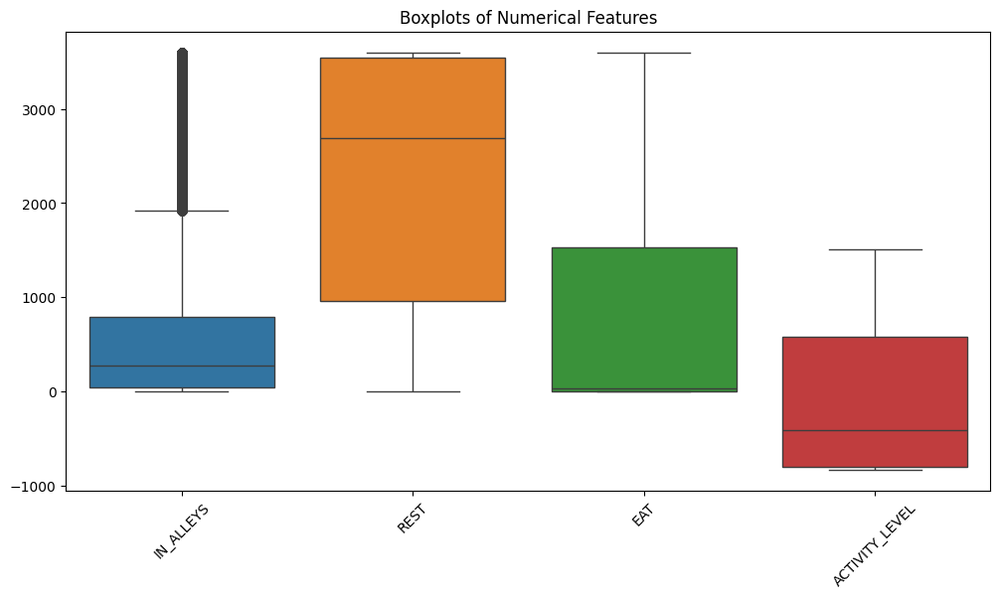

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select numerical columns for outlier analysis
numerical_cols = ['IN_ALLEYS', 'REST', 'EAT', 'ACTIVITY_LEVEL']

# Plot boxplots
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[numerical_cols])
plt.title('Boxplots of Numerical Features')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate IQR for each numerical column
for col in numerical_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    # Define bounds
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Find outliers
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    print(f"\nOutliers in {col}: {len(outliers)}")
    print(outliers[['cow', 'date', 'hour', col]].head())  # Show sample outliers


Outliers in IN_ALLEYS: 11408
       cow        date  hour  IN_ALLEYS
9    35687  2014-12-01    10   3599.999
10   35687  2014-12-01    11   3599.999
17   35687  2014-12-01    18   2159.014
104  35687  2014-12-05     9   3350.165
105  35687  2014-12-05    10   1966.416

Outliers in REST: 0
Empty DataFrame
Columns: [cow, date, hour, REST]
Index: []

Outliers in EAT: 0
Empty DataFrame
Columns: [cow, date, hour, EAT]
Index: []

Outliers in ACTIVITY_LEVEL: 0
Empty DataFrame
Columns: [cow, date, hour, ACTIVITY_LEVEL]
Index: []


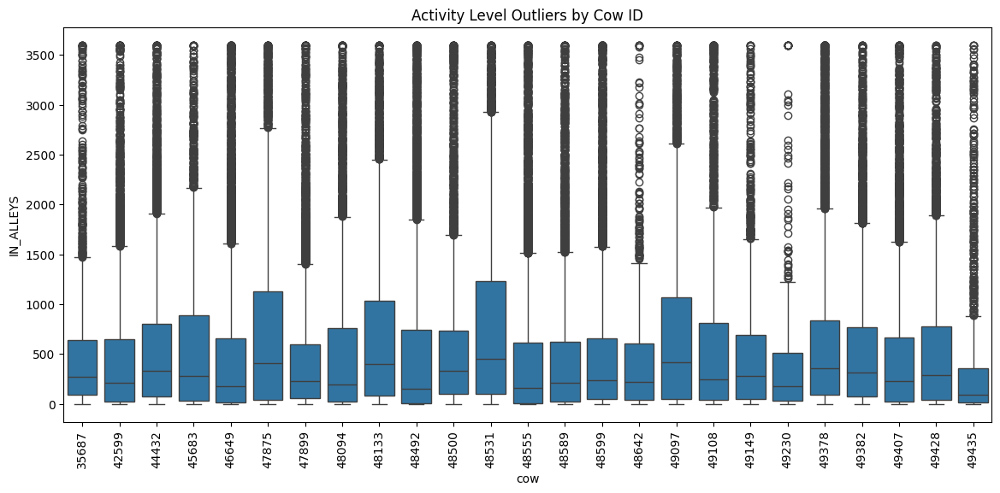

In [ ]:
plt.figure(figsize=(14, 6))
sns.boxplot(x='cow', y='IN_ALLEYS', data=df)
plt.title('Activity Level Outliers by Cow ID')
plt.xticks(rotation=90)
plt.show()

## Check missing days

### Check Date Range and Missing Dates

In [ ]:
# Convert 'date' to datetime
df['date'] = pd.to_datetime(df['date'])

# Get min/max dates
min_date = df['date'].min()
max_date = df['date'].max()
print(f"Date range: {min_date} to {max_date}")

# Generate all expected dates in the range
all_dates = pd.date_range(start=min_date, end=max_date, freq='D')
print(f"Total expected days: {len(all_dates)}")

# Check missing dates
missing_dates = all_dates.difference(df['date'].unique())
print(f"\nMissing dates {len(missing_dates)}:", ', '.join(missing_dates.strftime('%Y-%m-%d')))


Date range: 2014-12-01 00:00:00 to 2015-12-31 00:00:00
Total expected days: 396

Missing dates 2: 2015-07-05, 2015-07-06


### Check Completeness per Cow

In [ ]:
# Group by cow and count unique dates
cow_date_counts = df.groupby('cow')['date'].nunique()

# Compare against expected number of days
expected_days = len(all_dates)
missing_days_per_cow = expected_days - cow_date_counts

print("\nMissing days per cow:")
print(missing_days_per_cow[missing_days_per_cow > 0])


Missing days per cow:
cow
35687    313
42599      3
44432      3
45683    212
46649      3
47875      3
47899      3
48094     97
48133      3
48492     60
48500     97
48531      4
48555      3
48589      3
48599      3
48642    353
49097      3
49108    254
49149    277
49230    378
49378      4
49382      2
49407      3
49428      3
49435    323
Name: date, dtype: int64


In [ ]:
# Find missing days for each cow
missing_days = {}
for cow_id in df['cow'].unique():
    cow_dates = df[df['cow'] == cow_id]['date'].unique()
    missing_days[cow_id] = all_dates.difference(cow_dates)

# Display missing days for each cow
for cow_id, days in missing_days.items():
    if len(days) > 0:
        print(f"Cow {cow_id} is missing the following days:")
        print(', '.join(days.strftime('%Y-%m-%d')))

Cow 35687 is missing the following days:
2015-02-22, 2015-02-23, 2015-02-24, 2015-02-25, 2015-02-26, 2015-02-27, 2015-02-28, 2015-03-01, 2015-03-02, 2015-03-03, 2015-03-04, 2015-03-05, 2015-03-06, 2015-03-07, 2015-03-08, 2015-03-09, 2015-03-10, 2015-03-11, 2015-03-12, 2015-03-13, 2015-03-14, 2015-03-15, 2015-03-16, 2015-03-17, 2015-03-18, 2015-03-19, 2015-03-20, 2015-03-21, 2015-03-22, 2015-03-23, 2015-03-24, 2015-03-25, 2015-03-26, 2015-03-27, 2015-03-28, 2015-03-29, 2015-03-30, 2015-03-31, 2015-04-01, 2015-04-02, 2015-04-03, 2015-04-04, 2015-04-05, 2015-04-06, 2015-04-07, 2015-04-08, 2015-04-09, 2015-04-10, 2015-04-11, 2015-04-12, 2015-04-13, 2015-04-14, 2015-04-15, 2015-04-16, 2015-04-17, 2015-04-18, 2015-04-19, 2015-04-20, 2015-04-21, 2015-04-22, 2015-04-23, 2015-04-24, 2015-04-25, 2015-04-26, 2015-04-27, 2015-04-28, 2015-04-29, 2015-04-30, 2015-05-01, 2015-05-02, 2015-05-03, 2015-05-04, 2015-05-05, 2015-05-06, 2015-05-07, 2015-05-08, 2015-05-09, 2015-05-10, 2015-05-11, 2015-05-12,

In [ ]:
hourly_counts = df.groupby(['cow', 'date']).size().reset_index(name='hourly_records')
hourly_counts_48531 = hourly_counts[hourly_counts['cow'] == 48531]
print(hourly_counts_48531)

        cow       date  hourly_records
3559  48531 2014-12-01              24
3560  48531 2014-12-02              24
3561  48531 2014-12-03              24
3562  48531 2014-12-04              24
3563  48531 2014-12-05              24
...     ...        ...             ...
3946  48531 2015-12-27              24
3947  48531 2015-12-28              24
3948  48531 2015-12-29              24
3949  48531 2015-12-30              24
3950  48531 2015-12-31              24

[392 rows x 3 columns]


### The number of hourly entries per cow per day

In [ ]:
hourly_counts = df.groupby(['cow', 'date']).size().reset_index(name='hourly_records')
print(hourly_counts)

        cow       date  hourly_records
0     35687 2014-12-01              24
1     35687 2014-12-02              24
2     35687 2014-12-03              24
3     35687 2014-12-04              24
4     35687 2014-12-05              24
...     ...        ...             ...
7485  49435 2015-02-07              24
7486  49435 2015-02-08              24
7487  49435 2015-02-09              24
7488  49435 2015-02-10              24
7489  49435 2015-02-11              24

[7490 rows x 3 columns]


### Filter for days with exactly 24 hours records

In [ ]:
print("All days:", hourly_counts.shape[0])
full_days = hourly_counts[hourly_counts['hourly_records'] == 24]
print(f"\nDays with full days of records: {len(full_days)}")

if len(full_days) < hourly_counts.shape[0]:
    missing_hours = hourly_counts[hourly_counts['hourly_records'] < 24]
    print("Missing days are", missing_hours)


All days: 7490

Days with full days of records: 7489
Missing days are         cow       date  hourly_records
5565  49097 2015-12-31              23


### The number of full 24-hour days per cow

In [ ]:
full_days_per_cow = full_days.groupby('cow').size().reset_index(name='full_24h_days')
print("\nFull 24h days per cow:", full_days_per_cow)


Full 24h days per cow:       cow  full_24h_days
0   35687             83
1   42599            393
2   44432            393
3   45683            184
4   46649            393
5   47875            393
6   47899            393
7   48094            299
8   48133            393
9   48492            336
10  48500            299
11  48531            392
12  48555            393
13  48589            393
14  48599            393
15  48642             43
16  49097            392
17  49108            142
18  49149            119
19  49230             18
20  49378            392
21  49382            394
22  49407            393
23  49428            393
24  49435             73


In [ ]:
print(f"Percentage of complete days: {len(full_days)/len(hourly_counts)*100:.2f}%")

Percentage of complete days: 99.99%


### Count how many 24h samples have less than 12 observations

In [ ]:
less_than_12_obs = hourly_counts[hourly_counts['hourly_records'] >12 ]
print(f"Number of cow-day combinations with less than 12 hourly records: {len(less_than_12_obs)}")

if len(less_than_12_obs) > 0:
    print(less_than_12_obs)



Number of cow-day combinations with less than 12 hourly records: 7490
        cow       date  hourly_records
0     35687 2014-12-01              24
1     35687 2014-12-02              24
2     35687 2014-12-03              24
3     35687 2014-12-04              24
4     35687 2014-12-05              24
...     ...        ...             ...
7485  49435 2015-02-07              24
7486  49435 2015-02-08              24
7487  49435 2015-02-09              24
7488  49435 2015-02-10              24
7489  49435 2015-02-11              24

[7490 rows x 3 columns]


# We will execute this code on the dataset that has 24h with less than 12 observations

In [ ]:
df_filtered = df.copy()
if len(less_than_12_obs) > 0:
    #Filter for valid cow-date combinations (at least 12 hourly records)
    valid_days = hourly_counts[hourly_counts['hourly_records'] >= 12]

    #Merge back to original data to keep only valid records
    df_filtered = pd.merge(df, valid_days[['cow', 'date']], on=['cow', 'date'], how='inner')

    # df_filtered now excludes cow-date combos with <12 hours
    print(df_filtered)

          cow       date  hour  IN_ALLEYS      REST      EAT  ACTIVITY_LEVEL  \
0       35687 2014-12-01     1    268.600  3288.426   42.973      -695.31332   
1       35687 2014-12-01     2    169.599  3430.400    0.000      -761.85616   
2       35687 2014-12-01     3     35.068  3564.931    0.000      -814.32325   
3       35687 2014-12-01     4      0.000  3599.999    0.000      -827.99977   
4       35687 2014-12-01     5    207.026  3392.973    0.000      -747.25963   
...       ...        ...   ...        ...       ...      ...             ...   
179754  49097 2015-12-31    19    169.358  3430.641    0.000      -761.95020   
179755  49097 2015-12-31    20    430.159  3169.840    0.000      -660.23780   
179756  49097 2015-12-31    21    363.267  3213.537   23.195      -671.24890   
179757  49097 2015-12-31    22     80.048  3517.628    2.323      -795.27110   
179758  49097 2015-12-31    23   1592.418  1304.744  702.837       249.88730   

        oestrus  calving  lameness  mas

## Make One Hour Shift

In [ ]:
# condition_columns = ['oestrus', 'calving', 'lameness', 'mastitis', 'LPS',
#                     'acidosis', 'other_disease', 'accidents', 'disturbance',
#                     'mixing']

# window_size = 24
# shift = 1

# grouped = df.sort_values(['cow', 'date', 'hour']).groupby('cow')
# shifted_windows = []

# for cow_id, group in grouped:
#     activity = group['ACTIVITY_LEVEL'].values
#     for i in range(0, len(activity) - window_size + 1, shift):
#         window = activity[i:i + window_size]
#         last_hour_index = i + window_size - 1
#         if last_hour_index < len(group):
#             conditions = group.iloc[last_hour_index][condition_columns].to_dict()
#             shifted_windows.append({
#                 'cow': cow_id,
#                 'date': group.iloc[i]['date'],
#                 'start_hour': group.iloc[i]['hour'],
#                 'activity_window': window.tolist(),
#                 **conditions
#             })

# shifted_df = pd.DataFrame(shifted_windows)

# print("\nDataFrame info:")
# print(f"Total windows created: {len(shifted_df)}")
# print("\nFirst 3 windows:")
# display(shifted_df.head(3))
# print("\nColumn details:")
# display(shifted_df.info())


### Calculate the 32 features

In [ ]:
# import numpy as np
# from scipy import stats, fft
# import pandas as pd

# def calculate_all_features(activity_windows):
#     """
#     Calculate all 32 features for each 24-hour activity window.
#     Returns a DataFrame with one row per window and 32 feature columns.
#     as in the doc paragraph 2.2 considering table 3
#     """
#     features = []

#     for window in activity_windows:
#         try:
#             window = np.array(window)
#             if len(window) != 24:
#                 raise ValueError("Window must contain exactly 24 hours of data")

#             feature_dict = {}

#             # =============================================
#             # Time-Domain Features (1-17)
#             # =============================================

#             # Basic statistics (1-5)
#             feature_dict['Minimum'] = np.min(window)
#             feature_dict['Maximum'] = np.max(window)
#             feature_dict['Mean'] = np.mean(window)
#             feature_dict['RMS'] = np.sqrt(np.mean(np.square(window)))
#             feature_dict['STD'] = np.std(window)

#             # 6-hour window statistics (6-7)
#             six_h_windows = [window[i*6:(i+1)*6] for i in range(4)]
#             stds_6h = [np.std(w) for w in six_h_windows]
#             means_6h = [np.mean(w) for w in six_h_windows]
#             feature_dict['MeanSTD6h'] = np.mean(stds_6h)
#             feature_dict['STDMean6h'] = np.std(means_6h)

#             # Successive differences (9)
#             diffs = np.diff(window)
#             feature_dict['RMSSD'] = np.sqrt(np.mean(np.square(diffs)))

#             # Distribution characteristics (10-17)
#             feature_dict['Mode'] = stats.mode(window, keepdims=True)[0][0] if len(window) > 0 else np.nan
#             feature_dict['Q10'] = np.percentile(window, 10)
#             feature_dict['Q90'] = np.percentile(window, 90)
#             feature_dict['Q25'] = np.percentile(window, 25)
#             feature_dict['Q50'] = np.percentile(window, 50)
#             feature_dict['Q75'] = np.percentile(window, 75)
#             feature_dict['Skewness'] = stats.skew(window)
#             feature_dict['Kurtosis'] = stats.kurtosis(window)

#             # =============================================
#             # Autocorrelation Features (18-28)
#             # =============================================
#             for lag in range(1, 12):
#                 if len(window) > lag:
#                     corr = np.corrcoef(window[:-lag], window[lag:])[0,1]
#                 else:
#                     corr = np.nan
#                 feature_dict[f'Autocorr{lag}'] = corr

#             # =============================================
#             # Frequency-Domain Features (29-32)
#             # =============================================
#             fft_result = np.abs(fft.fft(window))
#             harmonics = fft_result[1:5]  # Skip 0-frequency, take harmonics 1-4
#             for i, h in enumerate(harmonics, 1):
#                 feature_dict[f'h{i}'] = h

#             features.append(feature_dict)

#         except Exception as e:
#             print(f"Error processing window: {e}")
#             # Return NaN for all features if error occurs
#             features.append({f: np.nan for f in FEATURE_NAMES})

#     return pd.DataFrame(features)

# FEATURE_NAMES = [
#     # Time-Domain (1-17)
#     'Minimum', 'Maximum', 'Mean', 'RMS', 'STD',
#     'MeanSTD6h', 'STDMean6h', 'RMSSD', 'Mode',
#     'Q10', 'Q90', 'Q25', 'Q50', 'Q75',
#     'Skewness', 'Kurtosis',
#     # Autocorrelation (18-28)
#     *[f'Autocorr{i}' for i in range(1,12)],
#     # Frequency-Domain (29-32)
#     *[f'h{i}' for i in range(1,5)]
# ]

# features_df = calculate_all_features(shifted_df['activity_window'])

# # Combine with original df
# final_df = pd.concat([shifted_df.reset_index(drop=True),
#                      features_df[FEATURE_NAMES]], axis=1)

# print("Feature calculation complete. Shape:", final_df.shape)
# display(final_df[FEATURE_NAMES].head(3))

### New dataset with one hour shift and the new 32 features

In [ ]:
# from scipy import stats, fft

# # 1. Define the feature calculation function (unchanged)
# def calculate_features(window):
#     """Calculate all 32 features for a 24-hour window"""
#     features = {}
#     window = np.array(window)

#     # Time-Domain Features (1-17)
#     features['Minimum'] = np.min(window)
#     features['Maximum'] = np.max(window)
#     features['Mean'] = np.mean(window)
#     features['RMS'] = np.sqrt(np.mean(np.square(window)))
#     features['STD'] = np.std(window)

#     # 6-hour window statistics
#     six_h_windows = [window[i*6:(i+1)*6] for i in range(4)]
#     stds_6h = [np.std(w) for w in six_h_windows]
#     means_6h = [np.mean(w) for w in six_h_windows]
#     features['MeanSTD6h'] = np.mean(stds_6h)
#     features['STDMean6h'] = np.std(means_6h)

#     # Successive differences
#     diffs = np.diff(window)
#     features['RMSSD'] = np.sqrt(np.mean(np.square(diffs)))

#     # Quantiles and distribution shape
#     try:
#         features['Mode'] = stats.mode(window, keepdims=True)[0][0]
#     except:
#         features['Mode'] = window[0]

#     for p in [10, 25, 50, 75, 90]:
#         features[f'Q{p}'] = np.percentile(window, p)
#     features['Skewness'] = stats.skew(window)
#     features['Kurtosis'] = stats.kurtosis(window)

#     # Autocorrelations (18-28)
#     for lag in range(1, 12):
#         if len(window) > lag:
#             corr = np.corrcoef(window[:-lag], window[lag:])[0,1]
#         else:
#             corr = np.nan
#         features[f'Autocorr{lag}'] = corr

#     # Frequency-Domain Features (29-32)
#     fft_values = np.abs(fft.fft(window))[1:5]  # Harmonics 1-4
#     for i, h in enumerate(fft_values, 1):
#         features[f'h{i}'] = h

#     return features

# # 2. Create 1-hour shifted windows (updated to exclude unwanted columns)
# def create_shifted_windows(df, window_size=24, shift=1):
#     """Generate overlapping 24-hour windows with 1-hour shift"""
#     shifted_data = []

#     # Define condition columns (excluding management_changes and OK)
#     condition_columns = ['oestrus', 'calving', 'lameness', 'mastitis', 'LPS',
#                         'acidosis', 'other_disease', 'accidents', 'disturbance',
#                         'mixing']

#     # Group by cow only (not date) for continuous windows
#     for cow_id, group in df.sort_values(['cow', 'date', 'hour']).groupby('cow'):
#         activity = group['ACTIVITY_LEVEL'].values
#         dates = group['date'].values
#         hours = group['hour'].values

#         # Generate all possible windows
#         for i in range(0, len(activity) - window_size + 1, shift):
#             window = activity[i:i + window_size]
#             conditions = group.iloc[i + window_size - 1][condition_columns].to_dict()

#             shifted_data.append({
#                 'cow': cow_id,
#                 'start_date': dates[i],
#                 'start_hour': hours[i],
#                 'activity_window': window.tolist(),
#                 **conditions
#             })

#     return pd.DataFrame(shifted_data)

# # 3. Process your data
# print("Creating 1-hour shifted windows (excluding management_changes and OK)...")
# shifted_df = create_shifted_windows(df)

# print("Calculating features for each window...")
# feature_data = [calculate_features(w) for w in shifted_df['activity_window']]
# features_df = pd.DataFrame(feature_data)

# # 4. Combine into final dataset
# final_df = pd.concat([
#     shifted_df.drop(columns=['activity_window']),  # Keep only metadata and conditions
#     features_df
# ], axis=1)

# # 5. Save the results
# output_path = "cow_activity_features_1hour_shift_clean.csv"
# final_df.to_csv(output_path, index=False)

# print(f"\nProcessing complete! Results saved to {output_path}")
# print(f"Final dataset shape: {final_df.shape}")
# print("\nFirst 3 rows of the final dataset:")
# display(final_df.head(3))

### Compute additional statistical metrics

In [ ]:
# daily_df = df_filtered.groupby(['cow', 'date']).agg({
#     'IN_ALLEYS': 'sum',
#     'REST': 'sum',
#     'EAT': 'sum',
#     'ACTIVITY_LEVEL': 'sum'
# }).reset_index()


# def rmse(x):
#     return np.sqrt(np.mean(x**2))

# #Compute statistical metrics per cow
# stats_df = daily_df.groupby('cow').agg(
#     min_IN_ALLEYS=('IN_ALLEYS', 'min'),
#     std_IN_ALLEYS=('IN_ALLEYS', 'std'),
#     quantile25_IN_ALLEYS=('IN_ALLEYS', lambda x: x.quantile(0.25)),
#     quantile50_IN_ALLEYS=('IN_ALLEYS', lambda x: x.quantile(0.5)),
#     quantile75_IN_ALLEYS=('IN_ALLEYS', lambda x: x.quantile(0.75)),
#     rmse_IN_ALLEYS=('IN_ALLEYS', rmse),

#     min_REST=('REST', 'min'),
#     std_REST=('REST', 'std'),
#     quantile25_REST=('REST', lambda x: x.quantile(0.25)),
#     quantile50_REST=('REST', lambda x: x.quantile(0.5)),
#     quantile75_REST=('REST', lambda x: x.quantile(0.75)),
#     rmse_REST=('REST', rmse),

#     min_EAT=('EAT', 'min'),
#     std_EAT=('EAT', 'std'),
#     quantile25_EAT=('EAT', lambda x: x.quantile(0.25)),
#     quantile50_EAT=('EAT', lambda x: x.quantile(0.5)),
#     quantile75_EAT=('EAT', lambda x: x.quantile(0.75)),
#     rmse_EAT=('EAT', rmse),

#     min_ACTIVITY=('ACTIVITY_LEVEL', 'min'),
#     std_ACTIVITY=('ACTIVITY_LEVEL', 'std'),
#     quantile25_ACTIVITY=('ACTIVITY_LEVEL', lambda x: x.quantile(0.25)),
#     quantile50_ACTIVITY=('ACTIVITY_LEVEL', lambda x: x.quantile(0.5)),
#     quantile75_ACTIVITY=('ACTIVITY_LEVEL', lambda x: x.quantile(0.75)),
#     rmse_ACTIVITY=('ACTIVITY_LEVEL', rmse)
# ).reset_index()


# print(stats_df)

In [ ]:
# ## plutot pas mal
# import pandas as pd
# from datetime import timedelta

# # Parameters
# window_size_hours = 24
# min_valid_hours = 12
# shift_hours = 1
# condition_columns = ['oestrus', 'calving', 'lameness', 'mastitis', 'LPS',
#                      'acidosis', 'other_disease', 'accidents', 'disturbance',
#                      'mixing']

# # Ensure datetime column exists and is sorted
# # Adjust hour 24 to 00 of the next day
# df['hour'] = df['hour'].apply(lambda x: 0 if x == 24 else x)
# df['date'] = df.apply(lambda row: row['date'] + timedelta(days=1) if row['hour'] == 0 else row['date'], axis=1)

# # Create timestamp column
# df['timestamp'] = pd.to_datetime(df['date'].astype(str) + ' ' + df['hour'].astype(str) + ':00:00')
# df = df.sort_values(['cow', 'timestamp'])

# # Group by cow
# grouped = df.groupby('cow')
# shifted_windows = []

# for cow_id, group in grouped:
#     timestamps = group['timestamp'].tolist()
#     group = group.set_index('timestamp')  # Set timestamp as index for lookup

#     print(f"\n🐄 Processing cow {cow_id} with {len(timestamps)} records...")

#     for start_time in timestamps:
#         end_time = start_time + timedelta(hours=window_size_hours)
#         collected_hours = []
#         current_time = start_time
#         previous_date = start_time.date()

#         while current_time < end_time:
#             current_date = current_time.date()

#             # Stop if there's a missing day
#             if (current_date - previous_date).days > 1:
#                 print(f"🛑 Stopping at {current_time} due to missing day.")
#                 break

#             if current_time in group.index:
#                 activity = group.loc[current_time]['ACTIVITY_LEVEL']
#             else:
#                 print(f"⚠️  Missing hour at {current_time}, treating ACTIVITY_LEVEL as 0.")
#                 # activity = 0  # Treat missing hour as zero activity

#             collected_hours.append(activity)
#             previous_date = current_date
#             current_time += timedelta(hours=1)

#         if len(collected_hours) >= min_valid_hours:
#             end_effective = start_time + timedelta(hours=len(collected_hours) - 1)
#             conditions = group.loc[start_time][condition_columns].to_dict() if start_time in group.index else {}
#             shifted_windows.append({
#                 'cow': cow_id,
#                 'start_time': start_time,
#                 'end_time': end_effective,
#                 'duration_hours': len(collected_hours),
#                 'activity_window': collected_hours,
#                 **conditions
#             })
#             print(f"✅ Valid window for cow {cow_id} from {start_time} to {end_effective} with {len(collected_hours)} hours (including 0s).")
#         else:
#             print(f"❌ Discarded window for cow {cow_id} from {start_time}: only {len(collected_hours)} total hours.")

# # Create DataFrame with valid windows
# shifted_df = pd.DataFrame(shifted_windows)

# print("\n✅ DONE.")
# print(f"Total valid windows collected: {len(shifted_df)}")
# display(shifted_df.head())


In [ ]:
# shifted_df.to_csv("shifted_windows_with_conditions.csv", index=False)

In [ ]:
import pandas as pd
from datetime import timedelta

# Parameters
window_size_hours = 24
min_valid_hours = 18
shift_hours = 1
condition_columns = ['oestrus', 'calving', 'lameness', 'mastitis', 'LPS',
                     'acidosis', 'other_disease', 'accidents', 'disturbance',
                     'mixing']

# Adjust hour 24 to 00 and increment the date
df['adjusted_date'] = df['date']
df['adjusted_hour'] = df['hour']
df.loc[df['hour'] == 24, 'adjusted_date'] = pd.to_datetime(df.loc[df['hour'] == 24, 'date']) + timedelta(days=1)
df.loc[df['hour'] == 24, 'adjusted_hour'] = 0

# Ensure datetime format
# Ensure adjusted_date is in datetime format
df['adjusted_date'] = pd.to_datetime(df['adjusted_date'])

# Combine adjusted_date and adjusted_hour into a timestamp
df['timestamp'] = pd.to_datetime(df['adjusted_date'].dt.strftime('%Y-%m-%d') + ' ' + df['adjusted_hour'].astype(str) + ':00:00')
df = df.sort_values(['cow', 'timestamp'])

# Group by cow
grouped = df.groupby('cow')
shifted_windows = []

for cow_id, group in grouped:
    timestamps = group['timestamp'].tolist()
    group = group.set_index('timestamp')  # Index by timestamp for easy lookup

    print(f"\n🐄 Processing cow {cow_id} with {len(timestamps)} records...")

    for start_time in timestamps:
        end_time = start_time + timedelta(hours=window_size_hours)
        collected_hours = []
        current_time = start_time
        previous_date = current_time.date()

        while current_time < end_time:
            if current_time in group.index:
                current_date = current_time.date()

                # Stop if there's a day gap
                if (current_date - previous_date).days > 1:
                    print(f"🛑 Stopping at {current_time} due to missing day.")
                    break

                collected_hours.append(group.loc[current_time]['ACTIVITY_LEVEL'])
                previous_date = current_date
                current_time += timedelta(hours=1)
            else:
                # Hour is missing, skip it but advance time
                print(f"⚠️  Missing hour at {current_time}, skipping.")
                current_date = current_time.date()

                if (current_date - previous_date).days > 0:
                    print(f"🛑 Stopping at {current_time} due to day gap after missing hour.")
                    break

                previous_date = current_date
                current_time += timedelta(hours=1)

        if len(collected_hours) >= min_valid_hours:
            end_effective = start_time + timedelta(hours=len(collected_hours) - 1)
            conditions = group.loc[start_time][condition_columns].to_dict() if start_time in group.index else {}
            shifted_windows.append({
                'cow': cow_id,
                'start_time': start_time,
                'end_time': end_effective,
                'duration_hours': len(collected_hours),
                'activity_window': collected_hours,
                **conditions
            })
            print(f"✅ Valid window for cow {cow_id} from {start_time} to {end_effective} with {len(collected_hours)} hours collected.")
        else:
            print(f"❌ Discarded window for cow {cow_id} from {start_time}: only {len(collected_hours)} valid hours.")

# Final DataFrame
shifted_df = pd.DataFrame(shifted_windows)

print("\n✅ DONE.")
print(f"Total valid windows collected: {len(shifted_df)}")
display(shifted_df.head())



🐄 Processing cow 35687 with 1992 records...
⚠️  Missing hour at 2014-12-02 00:00:00, skipping.
🛑 Stopping at 2014-12-02 00:00:00 due to day gap after missing hour.
✅ Valid window for cow 35687 from 2014-12-01 01:00:00 to 2014-12-01 23:00:00 with 23 hours collected.
⚠️  Missing hour at 2014-12-02 00:00:00, skipping.
🛑 Stopping at 2014-12-02 00:00:00 due to day gap after missing hour.
✅ Valid window for cow 35687 from 2014-12-01 02:00:00 to 2014-12-01 23:00:00 with 22 hours collected.
⚠️  Missing hour at 2014-12-02 00:00:00, skipping.
🛑 Stopping at 2014-12-02 00:00:00 due to day gap after missing hour.
✅ Valid window for cow 35687 from 2014-12-01 03:00:00 to 2014-12-01 23:00:00 with 21 hours collected.
⚠️  Missing hour at 2014-12-02 00:00:00, skipping.
🛑 Stopping at 2014-12-02 00:00:00 due to day gap after missing hour.
✅ Valid window for cow 35687 from 2014-12-01 04:00:00 to 2014-12-01 23:00:00 with 20 hours collected.
⚠️  Missing hour at 2014-12-02 00:00:00, skipping.
🛑 Stopping at 20

,cow,start_time,end_time,duration_hours,activity_window,oestrus,calving,lameness,mastitis,LPS,acidosis,other_disease,accidents,disturbance,mixing
0,35687,2014-12-01 01:00:00,2014-12-01 23:00:00,23,"[-695.31332, -761.85616, -814.32325, -827.9997...",0,0,0,0,NaN,NaN,0,0,0,0
1,35687,2014-12-01 02:00:00,2014-12-01 23:00:00,22,"[-761.85616, -814.32325, -827.99977, -747.2596...",0,0,0,0,NaN,NaN,0,0,0,0
2,35687,2014-12-01 03:00:00,2014-12-01 23:00:00,21,"[-814.32325, -827.99977, -747.25963, -827.9997...",0,0,0,0,NaN,NaN,0,0,0,0
3,35687,2014-12-01 04:00:00,2014-12-01 23:00:00,20,"[-827.99977, -747.25963, -827.99977, -825.7939...",0,0,0,0,NaN,NaN,0,0,0,0
4,35687,2014-12-01 05:00:00,2014-12-01 23:00:00,19,"[-747.25963, -827.99977, -825.79393, -790.4997...",0,0,0,0,NaN,NaN,0,0,0,0


In [ ]:
shifted_df.to_csv("shifted_windows_with_conditions5.csv", index=False)